In [1]:
import numpy as np
import pickle
import cv2
import tensorflow as tf
from os import listdir
from sklearn.preprocessing import LabelBinarizer
from keras.models import Sequential
from tensorflow.keras.layers import BatchNormalization, Conv2D, MaxPooling2D, Activation, Flatten, Dropout, Dense
from keras import backend as K
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam
from keras.preprocessing import image
from keras.preprocessing.image import img_to_array
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

2024-05-08 08:14:06.337504: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/scipy/__init__.py:155: UserWarning: A NumPy version >=1.18.5 and <1.25.0 is required for this version of SciPy (detected version 1.26.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
EPOCHS = 50
INIT_LR = 1e-3
BS = 16
default_image_size = tuple((64, 64))
image_size = 0
width=64
height=64
depth=3
image_size = 0
directory_root = 'Combined Data'

In [3]:
def convert_image_to_array(image_dir):
    try:
        image = cv2.imread(image_dir)
        if image is not None :
            image = cv2.resize(image, default_image_size)   
            return img_to_array(image)
        else :
            return np.array([])
    except Exception as e:
        print("Error :", e)
        return None

In [4]:
image_list, label_list = [], []
try:
    print("[INFO] Loading images ...")
    root_dir = listdir(directory_root)
    for directory in root_dir :
        # remove .DS_Store from list
        if directory == ".DS_Store" :
            root_dir.remove(directory)

    for plant_folder in root_dir :
       
        plant_disease_folder_list = listdir(f"{directory_root}/{plant_folder}")
        
        for disease_folder in plant_disease_folder_list :
            # remove .DS_Store from list
            if disease_folder == ".DS_Store" :
                plant_disease_folder_list.remove(disease_folder)

        for plant_disease_folder in plant_disease_folder_list:
            print(f"[INFO] Processing {plant_disease_folder} ...")
            plant_disease_image_list = listdir(f"{directory_root}/{plant_folder}/{plant_disease_folder}/")
                
            for single_plant_disease_image in plant_disease_image_list :
                if single_plant_disease_image == ".DS_Store" :
                    plant_disease_image_list.remove(single_plant_disease_image)

            for image in plant_disease_image_list:
                image_directory = f"{directory_root}/{plant_folder}/{plant_disease_folder}/{image}"
                if image_directory.endswith(".jpg") == True or image_directory.endswith(".JPG") == True:
                    image_list.append(convert_image_to_array(image_directory))
                    label_list.append(plant_disease_folder)
    print("[INFO] Image loading completed")  
except Exception as e:
    print(f"Error : {e}")

[INFO] Loading images ...
[INFO] Processing Maize_Common_Rust ...
[INFO] Processing MLN ...
[INFO] Processing HEATHLY ...
[INFO] Processing MSV ...
[INFO] Processing Maize_Blight ...
[INFO] Processing Maize_Gray_Leaf_Spot ...
[INFO] Image loading completed


In [5]:
image_size = len(image_list)
print(image_size)

6000


In [6]:
label_binarizer = LabelBinarizer()
image_labels = label_binarizer.fit_transform(label_list)
pickle.dump(label_binarizer,open('label_transform.pkl', 'wb'))
n_classes = len(label_binarizer.classes_)
print(label_binarizer.classes_)

['HEATHLY' 'MLN' 'MSV' 'Maize_Blight' 'Maize_Common_Rust'
 'Maize_Gray_Leaf_Spot']


In [7]:
np_image_list = np.array(image_list, dtype=np.float16) / 225.0

In [8]:
print("[INFO] Spliting data to train, test")
x_train, x_test, y_train, y_test = train_test_split(np_image_list, image_labels, test_size=0.20, random_state = 42)

[INFO] Spliting data to train, test


In [9]:
aug = ImageDataGenerator(
    rotation_range=25, width_shift_range=0.1,
    height_shift_range=0.1, shear_range=0.2, 
    zoom_range=0.2,horizontal_flip=True, 
    fill_mode="nearest")

In [10]:
import numpy as np
import pickle
import cv2
from os import listdir
from sklearn.preprocessing import LabelBinarizer
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from sklearn.model_selection import train_test_split
from keras.preprocessing.image import ImageDataGenerator
from keras import optimizers
from tensorflow.keras.metrics import Precision, Recall, AUC, TruePositives, TrueNegatives, FalsePositives, FalseNegatives


num_classes = 6  # Adjusted to 3 classes
input_shape = (64, 64, 3)
model = Sequential()
model.add(Conv2D(32, (5, 5), input_shape=input_shape, activation='relu', name="conv2d_1"))
model.add(MaxPooling2D(pool_size=(2, 2), name="max_pooling2d_1"))
model.add(Conv2D(32, (3, 3), activation='relu', name="conv2d_2"))
model.add(MaxPooling2D(pool_size=(2, 2), name="max_pooling2d_2"))
model.add(Conv2D(64, (3, 3), activation='relu', name="conv2d_3"))
model.add(MaxPooling2D(pool_size=(2, 2), name="max_pooling2d_3"))
model.add(Flatten(name="flatten_1"))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.25))
model.add(Dense(128, activation='relu'))
model.add(Dense(num_classes, activation='softmax'))

In [11]:
model.compile(loss='binary_crossentropy',
                  optimizer=optimizers.RMSprop(learning_rate=2e-5),
                  metrics=['acc',Precision(), Recall(), AUC(), TruePositives(), TrueNegatives(), FalsePositives(), FalseNegatives()])

In [12]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 60, 60, 32)        2432      
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 30, 30, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 28, 28, 32)        9248      
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 14, 14, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_3 (Conv2D)           (None, 12, 12, 64)        18496     
                                                                 
 max_pooling2d_3 (MaxPoolin  (None, 6, 6, 64)          0

In [13]:
import time
start_time = time.time()
history = model.fit(
    aug.flow(x_train, y_train, batch_size=BS),
    validation_data=(x_test, y_test),
    steps_per_epoch=len(x_train) // BS,
    epochs=EPOCHS,
    verbose=1
)
end_time = time.time()
training_time = end_time - start_time
print("Total training time:", training_time, "seconds")

Epoch 1/50
300/300 [==============================] - 31s 96ms/step - loss: 0.4877 - acc: 0.2037 - precision: 0.0000e+00 - recall: 0.0000e+00 - auc: 0.5520 - true_positives: 0.0000e+00 - true_negatives: 24000.0000 - false_positives: 0.0000e+00 - false_negatives: 4800.0000 - val_loss: 0.4418 - val_acc: 0.2650 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.6658 - val_true_positives: 0.0000e+00 - val_true_negatives: 6000.0000 - val_false_positives: 0.0000e+00 - val_false_negatives: 1200.0000
Epoch 2/50
300/300 [==============================] - 30s 101ms/step - loss: 0.4247 - acc: 0.3604 - precision: 0.7500 - recall: 0.0031 - auc: 0.7338 - true_positives: 15.0000 - true_negatives: 23995.0000 - false_positives: 5.0000 - false_negatives: 4785.0000 - val_loss: 0.3885 - val_acc: 0.5450 - val_precision: 1.0000 - val_recall: 0.0150 - val_auc: 0.8477 - val_true_positives: 18.0000 - val_true_negatives: 6000.0000 - val_false_positives: 0.0000e+00 - val_false_negatives: 1182.0000

Epoch 18/50
300/300 [==============================] - 29s 98ms/step - loss: 0.2029 - acc: 0.7450 - precision: 0.7784 - recall: 0.6952 - auc: 0.9523 - true_positives: 3337.0000 - true_negatives: 23050.0000 - false_positives: 950.0000 - false_negatives: 1463.0000 - val_loss: 0.2225 - val_acc: 0.7350 - val_precision: 0.7689 - val_recall: 0.6958 - val_auc: 0.9403 - val_true_positives: 835.0000 - val_true_negatives: 5749.0000 - val_false_positives: 251.0000 - val_false_negatives: 365.0000
Epoch 19/50
300/300 [==============================] - 29s 97ms/step - loss: 0.1986 - acc: 0.7500 - precision: 0.7860 - recall: 0.7056 - auc: 0.9544 - true_positives: 3387.0000 - true_negatives: 23078.0000 - false_positives: 922.0000 - false_negatives: 1413.0000 - val_loss: 0.1846 - val_acc: 0.7817 - val_precision: 0.8037 - val_recall: 0.7508 - val_auc: 0.9605 - val_true_positives: 901.0000 - val_true_negatives: 5780.0000 - val_false_positives: 220.0000 - val_false_negatives: 299.0000
Epoch 20/50
300/300 

Epoch 35/50
300/300 [==============================] - 30s 101ms/step - loss: 0.1578 - acc: 0.8081 - precision: 0.8226 - recall: 0.7904 - auc: 0.9697 - true_positives: 3794.0000 - true_negatives: 23182.0000 - false_positives: 818.0000 - false_negatives: 1006.0000 - val_loss: 0.1775 - val_acc: 0.7900 - val_precision: 0.8019 - val_recall: 0.7792 - val_auc: 0.9567 - val_true_positives: 935.0000 - val_true_negatives: 5769.0000 - val_false_positives: 231.0000 - val_false_negatives: 265.0000
Epoch 36/50
300/300 [==============================] - 31s 102ms/step - loss: 0.1558 - acc: 0.8163 - precision: 0.8302 - recall: 0.8017 - auc: 0.9698 - true_positives: 3848.0000 - true_negatives: 23213.0000 - false_positives: 787.0000 - false_negatives: 952.0000 - val_loss: 0.2023 - val_acc: 0.7483 - val_precision: 0.7549 - val_recall: 0.7392 - val_auc: 0.9454 - val_true_positives: 887.0000 - val_true_negatives: 5712.0000 - val_false_positives: 288.0000 - val_false_negatives: 313.0000
Epoch 37/50
300/300

In [14]:
precision = history.history['precision'][-1]
recall = history.history['recall'][-1]
f1 = 2 * (precision * recall) / (precision + recall)

print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1:.4f}')

Precision: 0.8394
Recall: 0.8188
F1 Score: 0.8289


In [15]:
acc = history.history['acc']
val_acc = history.history['val_acc']

# Print the final accuracy values
print(f'Training Accuracy: {acc[-1]:.4f}')
print(f'Validation Accuracy: {val_acc[-1]:.4f}')



Training Accuracy: 0.8281
Validation Accuracy: 0.8058


In [16]:
# ... (previous code)

# Evaluate the model on the test set
test_metrics = model.evaluate(x_test, y_test)

# Extract individual metric values
test_loss, test_accuracy, precision, recall, auc, true_positives, true_negatives, false_positives, false_negatives = test_metrics

# Print the testing accuracy
print(f"Testing Accuracy: {test_accuracy:.4f}")


38/38 [==============================] - 1s 31ms/step - loss: 0.1569 - acc: 0.8058 - precision: 0.8127 - recall: 0.8025 - auc: 0.9642 - true_positives: 963.0000 - true_negatives: 5778.0000 - false_positives: 222.0000 - false_negatives: 237.0000
Testing Accuracy: 0.8058


In [17]:
# Print additional metrics for training
print(f"Precision: {history.history['precision'][-1]:.4f}")

print(f"Recall: {history.history['recall'][-1]:.4f}")
print(f"AUC: {history.history['auc'][-1]:.4f}")
print(f"True Positives: {history.history['true_positives'][-1]:.4f}")
print(f"True Negatives: {history.history['true_negatives'][-1]:.4f}")
print(f"False Positives: {history.history['false_positives'][-1]:.4f}")
print(f"False Negatives: {history.history['false_negatives'][-1]:.4f}")

Precision: 0.8394
Recall: 0.8188
AUC: 0.9727
True Positives: 3930.0000
True Negatives: 23248.0000
False Positives: 752.0000
False Negatives: 870.0000


dict_keys(['loss', 'acc', 'precision', 'recall', 'auc', 'true_positives', 'true_negatives', 'false_positives', 'false_negatives', 'val_loss', 'val_acc', 'val_precision', 'val_recall', 'val_auc', 'val_true_positives', 'val_true_negatives', 'val_false_positives', 'val_false_negatives'])


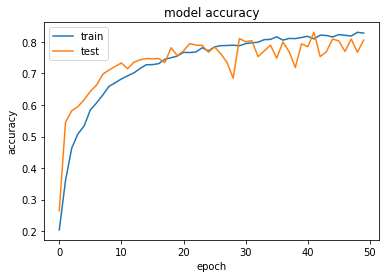

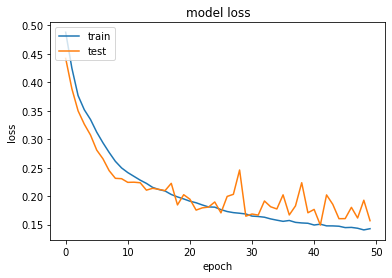

In [18]:
print(history.history.keys())
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

38/38 [==============================] - 2s 37ms/step


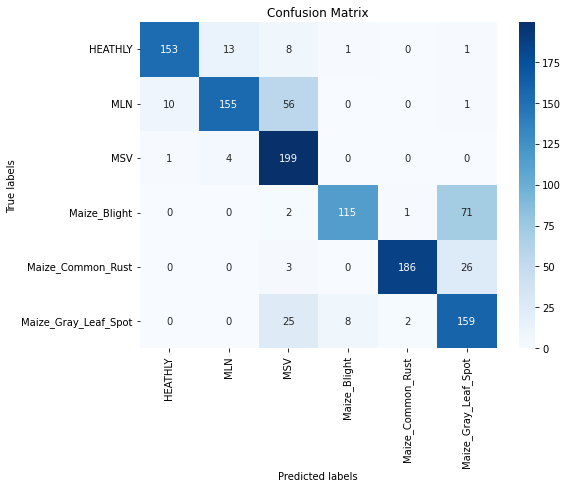

In [19]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Predicting the classes for the test set
y_pred = model.predict(x_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_true_classes = np.argmax(y_test, axis=1)

# Generate confusion matrix
conf_matrix = confusion_matrix(y_true_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=label_binarizer.classes_, yticklabels=label_binarizer.classes_)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()


In [20]:
model.save(f'./model/customCNN_combined.h5')

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [21]:
import os
[  os.listdir("./model")]

[['.DS_Store',
  'customCNN_combined.h5',
  '9',
  '7',
  '111',
  '6',
  '1',
  'AlexNet_nb.h5',
  'vgg_combined.h5',
  'resnet50_combined.h5',
  'resnet50.h5',
  'vgg16_nb.h5',
  'mobilenet_combined.h5',
  'customcnn_nb.h5',
  '112',
  'MobieNet_nb.h5',
  '4',
  '3',
  '12',
  '2',
  '5']]

In [23]:
import numpy as np

for images_batch, labels_batch in x_test.take(1):
    first_image = images_batch[0].numpy().astype('uint8')
    first_label_index = np.argmax(labels_batch[0].numpy())
    
    print("first image to predict")
    plt.imshow(first_image)
    print("actual label:", class_names[first_label_index])
    
    batch_prediction = model.predict(images_batch)
    print("predicted label:", class_names[np.argmax(batch_prediction[0])])


TypeError: 'numpy.float16' object is not iterable

In [35]:
import numpy as np
from keras.models import load_model
from keras.preprocessing import image
model=load_model(f'./model/customCNN_combined.h5')

38/38 [==============================] - 1s 31ms/step


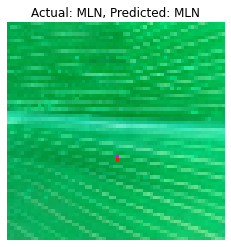

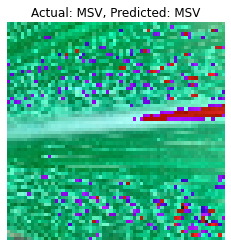

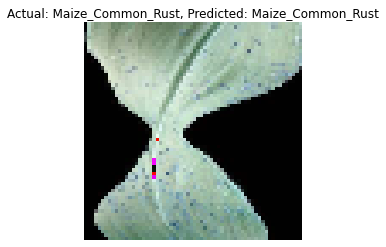

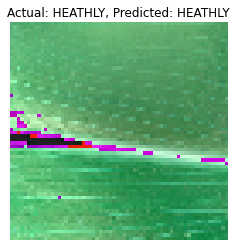

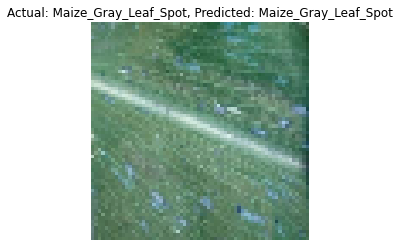

...

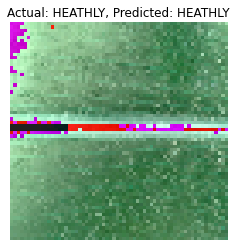

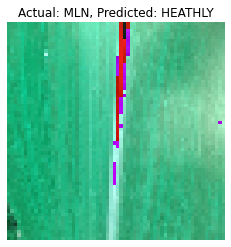

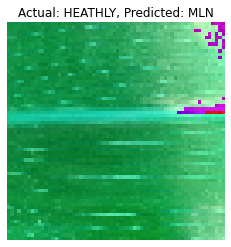

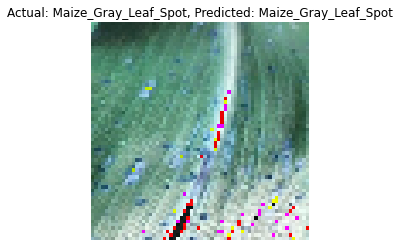

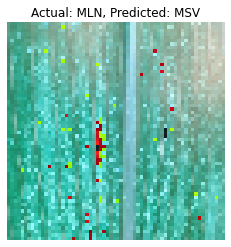

In [36]:
import numpy as np
import pickle
import matplotlib.pyplot as plt

# Load the label binarizer
with open('label_transform.pkl', 'rb') as f:
    label_binarizer = pickle.load(f)

# Assuming class_names is defined elsewhere in your code
class_names = label_binarizer.classes_


# Function to preprocess a single image
def preprocess_image(image):
    image = tf.image.resize(image, (64, 64))  # Resize image
    image /= 255.0  # Normalize pixel values
    return image

# Function to decode label indices to class names
def decode_labels(encoded_labels):
    decoded_labels = label_binarizer.inverse_transform(encoded_labels)
    return decoded_labels

# Make predictions on the test set
predictions = model.predict(x_test)

# Iterate over the test set and make predictions
for i in range(len(x_test)):
    image = (x_test[i] * 255).astype(np.uint8)  # Convert normalized image back to uint8
    actual_label = decode_labels(np.expand_dims(y_test[i], axis=0))[0]
    predicted_label_index = np.argmax(predictions[i])
    predicted_label = class_names[predicted_label_index]
    
    # Display the image and predictions
    plt.imshow(image)
    plt.title(f'Actual: {actual_label}, Predicted: {predicted_label}')
    plt.axis('off')
    plt.show()
